c:\Users\1\AppData\Local\Programs\Python\Python38-32\lib\site-packages\pm4py\visualization\petrinet\__init__.py:20: UserWarning: please use the pm4py.visualization.petri_net package instead
  warnings.warn("please use the pm4py.visualization.petri_net package instead")
parsing log, completed traces :: 100%|██████████| 100000/100000 [00:27<00:00, 3601.71it/s]


########################################################


Longitud de traza mas grande : 217
Longitud de traza mas chica : 1
Longitud promedio de traza : 4.51359



########################################################


########################################################


1 A,B,C,D,E,
2 A,F,
3 A,B,C,D,G,H,B,C,D,E,
4 A,B,C,D,E,
5 A,H,B,C,D,E,
6 A,H,B,C,D,E,
7 A,H,B,C,D,E,
8 A,H,B,C,D,E,
9 A,H,H,B,C,D,E,
10 A,H,B,C,D,E,
11 A,H,B,C,D,E,
12 A,F,
13 A,H,B,C,D,E,
14 A,B,C,D,E,
15 A,H,B,C,D,E,
16 A,H,B,C,D,E,
17 A,H,B,C,D,E,I,J,E,
18 A,H,B,C,D,E,
19 A,H,B,C,D,E,
20 A,H,H,H,B,C,D,E,
21 A,
22 A,
23 A,H,B,C,D,E,
24 A,H,F,
25 A,H,B,C,D,E,
26 A,H,B,C,D,G,B,C,D,E,
27 A,H,B,C,D,E,
28 A,B,C,D,E,
29 A,B,C,D,E,
30 A,B,C,D,E,
31 A,B,C,D,E,
32 A,B,C,D,E,
33 A,B,C,D,E,
34 A,B,C,D,E,
35 A,H,B,C,D,E,
36 A,H,B,C,D,E,
37 A,F,
38 A,H,B,C,D,E,
39 A,B,C,D,E,
40 A,
41 A,B,C,D,E,
42 A,F,
43 A,B,C,D,E,
44 A,B,C,D,E,
45 A,B,C,D,E,
46 A,B,C,D,E,
47 A,B,C,D,E,
48 A,B,C,D,E,
49 A,B,C,D,E,
50 A,B,C,D,E,
51 A,

<ipython-input-1-ba2cf84184fb>:394: DeprecatedWarning: discover_tree_inductive is deprecated as of 2.2.2 and will be removed in 2.4.0. discover_tree_inductive is deprecated, use discover_process_tree_inductive
  process_tree2 = pm4py.discover_tree_inductive(log2)


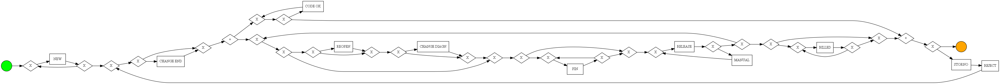

aligning log, completed variants :: 100%|██████████| 1020/1020 [00:12<00:00, 81.86it/s]


<module 'pm4py.algo.conformance.alignments.petri_net.algorithm' from 'c:\\Users\\1\\AppData\\Local\\Programs\\Python\\Python38-32\\lib\\site-packages\\pm4py\\algo\\conformance\\alignments\\petri_net\\algorithm.py'>
{'alignment': [('>>', None), ('NEW', 'NEW'), ('>>', None), ('>>', None), ('FIN', 'FIN'), ('RELEASE', 'RELEASE'), ('>>', None), ('>>', None), ('CODE OK', 'CODE OK'), ('BILLED', 'BILLED'), ('>>', None), ('>>', None), ('>>', None), ('>>', None), ('>>', None), ('>>', None)], 'cost': 11, 'visited_states': 23, 'queued_states': 63, 'traversed_arcs': 68, 'lp_solved': 3, 'fitness': 1.0}
{'alignment': [('>>', None), ('NEW', 'NEW'), ('DELETE', '>>'), ('>>', None), ('>>', None), ('>>', 'CHANGE DIAGN'), ('>>', None), ('>>', None)], 'cost': 20005, 'visited_states': 8, 'queued_states': 17, 'traversed_arcs': 19, 'lp_solved': 4, 'fitness': 0.5}
{'alignment': [('>>', None), ('NEW', 'NEW'), ('>>', None), ('>>', None), ('FIN', 'FIN'), ('RELEASE', 'RELEASE'), ('>>', None), ('>>', None), ('CODE O

In [1]:
# data
from audioop import reverse
import pandas as pd
import pm4py
from pm4py.objects.conversion.log import converter as log_converter
from pm4py.objects.log.importer.xes import importer as xes_importer
from pm4py.objects.log.exporter.xes import exporter as xes_exporter
from pm4py.objects.log.util import dataframe_utils
from pm4py import format_dataframe

# process mining 
from pm4py.algo.discovery.alpha import algorithm as alpha_miner
from pm4py.algo.discovery.inductive import algorithm as inductive_miner
from pm4py.algo.discovery.heuristics import algorithm as heuristics_miner
from pm4py.algo.discovery.dfg import algorithm as dfg_discovery

# viz
from pm4py.visualization.petrinet import visualizer as pn_visualizer
from pm4py.visualization.process_tree import visualizer as pt_visualizer
from pm4py.visualization.heuristics_net import visualizer as hn_visualizer
from pm4py.visualization.dfg import visualizer as dfg_visualization

# misc 
from pm4py.objects.conversion.process_tree import converter as pt_converter



#Trazas

import pandas as pd
import numpy as np
import copy

from sympy import re

# KL Divergente
import math


# Python code to sort the tuples using second element 
# of sublist Inplace way to sort using sort()
def Sort(sub_li):
  
    # reverse = None (Sorts in Ascending order)
    # key is set to sort using second element of 
    # sublist lambda has been used
    sub_li.sort(key = lambda x: x[1], reverse=1)
    return sub_li

# Funcion para calcular la seleccion por probabilidad de frecuencias
def prob(a,b,trazas):
    cont=0
    total=len(trazas)
    for x in trazas:
        for y in range(2,len(x)):
            if x[y-1]==a and x[y]==b:
                cont=cont+1
                break
    return cont/total

# Funcion para ordenar los resultados de seleccion de frecuencias
def ordenar(e):
    return e[-1]



##Dicionarios para contar las trazas
TrazasSinRepetir = list()

##Dicionarios para combertir de evento <-> letra y evento <-> numero
ActividadesN = dict()
ActividadesL = dict()
ActividadesNI = dict()
ActividadesLI = dict()

##Contador de eventos
contA=0
##Inicializar lista de trazas
listaTraza=list()

#nombrearchivo="Sepsis Cases - Event LogArtificial.xes"
#nombrearchivo="CCC19LogCSV.csv"
#nombrearchivo="ArtificialPatientTreatment.csv"
#nombrearchivo="example.xes"
nombrearchivo="Hospital Billing - Event Log.xes"
# nombrearchivo="Sepsis Cases - Event Log.xes"


if nombrearchivo[-3:]=="xes":
    log = xes_importer.apply(nombrearchivo)
    log = log_converter.apply(log)
    dataframe = log_converter.apply(log, variant=log_converter.Variants.TO_DATA_FRAME)
elif nombrearchivo[-3:]=="csv":
    dataframe = pd.read_csv(nombrearchivo, sep=',')
    dataframe = pm4py.format_dataframe(dataframe, case_id='patient', activity_key='action', timestamp_key='DateTime')
    log = pm4py.convert_to_event_log(dataframe)


eventkey='concept:name'

log2 = pm4py.objects.log.obj.EventLog()


########## Inicio de Lectura de trazas ###################

##Recorrer el log de eventos y registrar cada evento
c2=0
trazaMG=0
trazaMC=10000
trazapromedio=0
sumatamanoTraza=0
for x in log:
    Traza=list()
    Traza.append(x)
    for y in x:
        evento = y[eventkey]
        if evento not in ActividadesN:
            contA=contA+1
            ##Registrar el evento en los diccionarios de evento
            ActividadesN[evento]=contA
            ActividadesL[evento]=chr(contA+64)
            ActividadesNI[contA]=evento
            ActividadesLI[chr(contA+64)]=evento
        ##Generar la traza en envetos tipo A,B,C,D,D,F
        Traza.append(ActividadesL[evento])
    ##Agregar la traza a la lista de trazas sin repetir y contar incidencias
    # print("########################################################\n")
    ban=1
    for x in TrazasSinRepetir:
        if x[0][1:]==Traza[1:]:
            ban=0
            x[1]=x[1]+1
            break
    if ban==1:
        laux=list()
        laux.append(Traza.copy())
        laux.append(1)
        TrazasSinRepetir.append(laux.copy())
    
    sumatamanoTraza=sumatamanoTraza+len(Traza)-1
    if len(Traza)-1>trazaMG:
        trazaMG=len(Traza)-1
    if len(Traza)-1<trazaMC:
        trazaMC=len(Traza)-1

    listaTraza.append(Traza)

## Calculo de Varianza ##
    ## Agrupar por trazas iguales ##
    #Ordenar las trazas por numero de incidencias

TrazasSinRepetir=Sort(TrazasSinRepetir)

########## Imprimir datos de trazas#############
print("########################################################\n\n")
trazapromedio=sumatamanoTraza/len(listaTraza)
print("Longitud de traza mas grande : "+str(trazaMG))
print("Longitud de traza mas chica : "+str(trazaMC))
print("Longitud promedio de traza : "+str(trazapromedio))
print("\n\n")
print("########################################################\n\n")
########## Imprimir Trazas ###################
i=1
print("########################################################\n\n")
for x in listaTraza:
    print(i, end=" ")
    for y in range(1,len(x)):
        print(x[y], end=",")
    print()
    i=i+1
print("########################################################\n\n")

##Buscar frecuencias relativas
for x in TrazasSinRepetir:
    fr=x[1]/len(listaTraza)
    x.append(fr)

##Calcular varianza
sumas=0
for x in TrazasSinRepetir:
    sumas=sumas+(x[2]**2)

k=len(TrazasSinRepetir)
varianza=(1-(sumas))/((k-1)/k)


# Dp
# l numero de eventos en todas las trasas
# n numero de trasas
# s arreglo con datos de cada n/l
# f numero de evento en todas las trazas
# v arreglo con las frecuencias de evento por traza
ldato=0
slista=list()

for x in listaTraza:
    tt=len(x[1:])
    ldato=ldato+tt
    slista.append(tt)
n=len(listaTraza)

myArray = np.array(slista)
myInt = ldato
newArray = myArray/myInt


leventos=list(ActividadesL.values())
veventos=list()
feventos=list()


for x in leventos:
    # calcular f y v
    v=list()
    f=0
    for y in listaTraza:
        z=y[1:]
        count_a = z.count(x)
        f=f+count_a
        v.append(count_a)
    veventos.append(v)
    feventos.append(f)


# Calculo de DP
DP=0
resultadosdp=list()

for x in range(0,len(leventos)):
    resultado=0
    for y in range(0,n):
        resultado=resultado+abs((veventos[x][y]/feventos[x])-newArray[y])
    dpsinnorml=0.5*resultado
    resultadosdp.append( round(dpsinnorml, 2))

    DP=DP+dpsinnorml



myArray2 = np.array(resultadosdp)
DPpromedio=np.average(myArray2)
# Fin de calculo de DP


# Calculo de KL Divergencia
KLd=0
resultadosKLd=list()

for x in range(0,len(leventos)):
    resultado=0
    for y in range(0,n):
        try:
            reslog=math.log2((veventos[x][y]/feventos[x])*(1/newArray[y]))
        except ValueError:
            reslog=0
        formula=(veventos[x][y]/feventos[x])*reslog
        resultado=resultado+formula
        
    KLDnorml=resultado
    
    # print(KLDnorml)
    # print("\n")
    resultadosKLd.append( round(KLDnorml, 2))


    KLd=KLd+KLDnorml

# print(KLd)

myArray3 = np.array(resultadosKLd)
KLpromedio=np.average(myArray3)

# Fin de calculo de KLdivergente


########## Imprimir Trazas sin repetir ###################
i=1
print("########################################################\n\n")
for x in TrazasSinRepetir:
    print(i, end=" ")
    noMostrar=0
    for y in x:
        if noMostrar==0:
            print(y[1:], end=", ")
            noMostrar=+1
        else:
            print(y, end=", ")
    print()
    i=i+1
print("########################################################\n\n")


# print("IVC= "+str(varianza))
print("Datos DP")
for x in range(0,len(resultadosdp)):
    print(str(leventos[x])+" : "+str(resultadosdp[x]))
print("DP promedio= "+str(DPpromedio))
print("\n")

print("Datos KL")
for x in range(0,len(resultadosKLd)):
    print(str(leventos[x])+" : "+str(resultadosKLd[x]))
print("KLdivergente promedio= "+str(KLpromedio))
print("\n")





########## Fin de Lectura de trazas ###################

########## Variables de seleccion ###################
Pusuario = .5
umbral = .5
TotalTrazasSelecc=len(listaTraza)*Pusuario



########## Seleccion de Instancias  ###################

if DPpromedio<umbral:
    print("Seleccion de instancias por frecuencia")
    
    print("Se seleccionaran "+str(TotalTrazasSelecc) + "Trazas")
    con=0
    SI=list()
    for x in TrazasSinRepetir:
        for y in range(0,x[1]):
            SI.append(x[0].copy())
            con=con+1
            if len(SI)>=TotalTrazasSelecc:
                break
        if len(SI)>=TotalTrazasSelecc:
            break
    c=0 
    for x in SI:
        log2.append(x[0])
        print(c,end=" :")
        print(x[1:])
        c=c+1
    # ########## Inicio de BPMN de SI ###################
    # print("\n\nBPMN de la seleccion de instancias\n\n")
    # process_tree2 = pm4py.discover_tree_inductive(log2)
    # bpmn_model2 = pm4py.convert_to_bpmn(process_tree2)
    # pm4py.view_bpmn(bpmn_model2)

    # ########## Fin de BPMN de SI ###################
    ########## Inicio de BPMN completo ###################
    print("\n\nBPMN completo\n\n")
    process_tree = pm4py.discover_tree_inductive(log)
    bpmn_model = pm4py.convert_to_bpmn(process_tree)
    pm4py.view_bpmn(bpmn_model)

    ########## Fin de BPMN completo ###################
    # Alineamiento
    net, initial_marking, final_marking = inductive_miner.apply(log)
    from pm4py.algo.conformance.alignments.petri_net import algorithm as alignments
    aligned_traces = alignments.apply_log(log, net, initial_marking, final_marking)
    print(alignments)
    for x in aligned_traces:
        print(x)
    from pm4py.algo.evaluation.replay_fitness import algorithm as replay_fitness
    log_fitness = replay_fitness.evaluate(aligned_traces, variant=replay_fitness.Variants.ALIGNMENT_BASED)

    print(log_fitness) 

        


elif DPpromedio>=umbral:
    print("Selección de instancias por similitud")
    print("Se seleccionaran "+str(TotalTrazasSelecc) + "Trazas")
    ########## Seleccion por patrones de secuencia frecuentes ###################
    for x in listaTraza:
        contval=0
        for y in range(2,len(x)):
            if prob(str(x[y-1]),str(x[y]),listaTraza) >= Pusuario:
                contval=contval+1
            else:
                contval=contval-1
        x.append(contval)
    listaTraza.sort(reverse=True, key=ordenar)
    c=0
    for x in listaTraza:
        # print(x)
        print(x[1:])
        log2.append(x[0])
        c=c+1
        if c==TotalTrazasSelecc:
            break
    print(c)
    ########## Inicio de BPMN de SI ###################
    print("\n\nBPMN de la seleccion de instancias\n\n")
    process_tree2 = pm4py.discover_tree_inductive(log2)
    bpmn_model2 = pm4py.convert_to_bpmn(process_tree2)
    pm4py.view_bpmn(bpmn_model2)

    ########## Fin de BPMN de SI ###################
    # Alineamiento
    net, initial_marking, final_marking = inductive_miner.apply(log2)
    from pm4py.algo.conformance.alignments.petri_net import algorithm as alignments
    aligned_traces = alignments.apply_log(log, net, initial_marking, final_marking)
    print(alignments)
    for x in aligned_traces:
        print(x)
    from pm4py.algo.evaluation.replay_fitness import algorithm as replay_fitness
    log_fitness = replay_fitness.evaluate(aligned_traces, variant=replay_fitness.Variants.ALIGNMENT_BASED)

    print(log_fitness) 